In [45]:
# importing required library to perform feature selection
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

# importing the dataset
input_file = "chowdary.csv"
df = pd.read_csv(input_file)

# seperating the independent and dependent variables
X = df.iloc[:, 3:]
Y = df.iloc[:, 1]

# splitting the dataset into training and testing set
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=None)

scaler = StandardScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)

# Convert back to DataFrame
X_train_normalized_df = pd.DataFrame(X_train_normalized, columns=X_train.columns)
X_test_normalized_df = pd.DataFrame(X_test_normalized, columns=X_test.columns)

# summarizing the dataset
# number of 'B' and 'C' in training and testing set
print("The number of 'B' and 'C' in training set: ", Y_train.value_counts())
print("The number of 'B' and 'C' in testing set: ", Y_test.value_counts())
print("The shape of the training set is: ", X_train_normalized_df.shape)
print("The shape of the testing set is: ", X_test_normalized_df.shape)

The number of 'B' and 'C' in training set:  tumour
B    48
C    35
Name: count, dtype: int64
The number of 'B' and 'C' in testing set:  tumour
B    14
C     7
Name: count, dtype: int64
The shape of the training set is:  (83, 181)
The shape of the testing set is:  (21, 181)


In [46]:
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

encoder = LabelEncoder()
Y_train_encoded = encoder.fit_transform(Y_train)
Y_test_encoded = encoder.transform(Y_test)

# Define the logistic regression model with L1 penalty
log_reg_l1 = LogisticRegression(penalty='l1', solver='liblinear', max_iter=1000)

# Define the hyperparameters grid
param_grid = {
    'C': np.logspace(-4, 4, 50)
}

# Create the GridSearchCV object
grid_search_l1 = GridSearchCV(estimator=log_reg_l1, param_grid=param_grid, cv=5, scoring='accuracy')

# Fit the GridSearchCV object to the training data
grid_search_l1.fit(X_train_normalized_df, Y_train_encoded)

# Print the best hyperparameters
print("Best parameters: ", grid_search_l1.best_params_)

# Get the selected features
selected_features = X_train_normalized_df.columns[grid_search_l1.best_estimator_.coef_[0] != 0]
print("Selected features: ", selected_features)

Best parameters:  {'C': 11.513953993264458}
Selected features:  Index(['X201496_x_at', 'X201525_at', 'X201884_at', 'X201909_at',
       'X202286_s_at', 'X202376_at', 'X202831_at', 'X202859_x_at',
       'X203691_at', 'X204351_at', 'X204470_at', 'X204653_at', 'X206286_s_at',
       'X207850_at', 'X209016_s_at', 'X209343_at', 'X209351_at',
       'X209604_s_at', 'X211798_x_at', 'X212942_s_at', 'X213953_at',
       'X215108_x_at', 'X217157_x_at'],
      dtype='object')


Best parameters:  {'C': 0.01}
              precision    recall  f1-score   support

           0       0.93      1.00      0.97        14
           1       1.00      0.86      0.92         7

    accuracy                           0.95        21
   macro avg       0.97      0.93      0.94        21
weighted avg       0.96      0.95      0.95        21



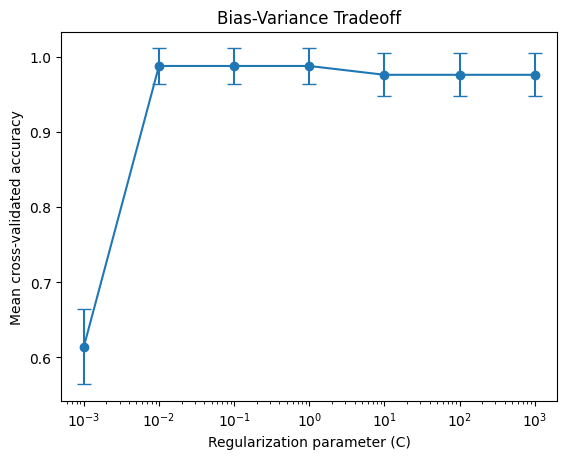

In [47]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report

X_train_selected = X_train_normalized_df[selected_features]
X_test_selected = X_test_normalized_df[selected_features]

# Initialize the logistic regression model
lr = LogisticRegression(penalty='l2', max_iter=1000)

# Define the hyperparameters grid
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000]}

# Create the GridSearchCV object
grid_search_lr = GridSearchCV(estimator=lr, param_grid=param_grid, cv=5, scoring='accuracy')

# Fit the GridSearchCV object to the training data
grid_search_lr.fit(X_train_selected, Y_train_encoded)

# Print the best hyperparameters
print("Best parameters: ", grid_search_lr.best_params_)

# Use the best model for making predictions
best_lr = grid_search_lr.best_estimator_
Y_pred = best_lr.predict(X_test_selected)

# Print the classification report
print(classification_report(Y_test_encoded, Y_pred))

# Plot the bias-variance tradeoff
mean_test_scores = grid_search_lr.cv_results_['mean_test_score']
std_test_scores = grid_search_lr.cv_results_['std_test_score']

plt.errorbar(param_grid['C'], mean_test_scores, yerr=std_test_scores, fmt='o-', capsize=5)
plt.xscale('log')
plt.xlabel('Regularization parameter (C)')
plt.ylabel('Mean cross-validated accuracy')
plt.title('Bias-Variance Tradeoff')
plt.show()

In [120]:
# Calculate the log-likelihood
log_likelihood = best_lr.predict_log_proba(X_train_selected).sum()

# Calculate the number of parameters (k) and samples (n)
k = len(selected_features) + 1  # Add 1 for the intercept
n = X_train_selected.shape[0]

# Calculate AIC and BIC
aic = -2 * log_likelihood + 2 * k
bic = -2 * log_likelihood + k * np.log(n)

print("AIC: ", aic)
print("BIC: ", bic)

AIC:  328.72097359332986
BIC:  386.77314818044823


In [56]:
# getting the coefficients for the selected features
coefficients = pd.DataFrame({'feature': list(selected_features), 'coefficient': best_lr.coef_[0]})
print(coefficients)

         feature  coefficient
0   X201496_x_at     0.046530
1     X201525_at    -0.084479
2     X201884_at     0.077184
3     X201909_at     0.065261
4   X202286_s_at    -0.151896
5     X202376_at    -0.106160
6     X202831_at     0.079691
7   X202859_x_at     0.096413
8     X203691_at     0.052885
9     X204351_at     0.090927
10    X204470_at     0.071207
11    X204653_at    -0.142789
12  X206286_s_at     0.068531
13    X207850_at     0.074729
14  X209016_s_at    -0.122921
15    X209343_at    -0.145733
16    X209351_at    -0.072354
17  X209604_s_at    -0.139936
18  X211798_x_at     0.009633
19  X212942_s_at     0.056510
20    X213953_at     0.054391
21  X215108_x_at     0.053574
22  X217157_x_at    -0.003363


d:\TCD\Term2\applied-statistics\main\my_env\Lib\site-packages\sklearn\model_selection\_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(
d:\TCD\Term2\applied-statistics\main\my_env\Lib\site-packages\sklearn\model_selection\_validation.py:378: FitFailedWarning: 
7 fits failed out of a total of 35.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
7 fits failed with the following error:
Traceback (most recent call last):
  File "d:\TCD\Term2\applied-statistics\main\my_env\Lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "d:\TCD\Term2\applied-statistics\main\my_env\Lib\site-

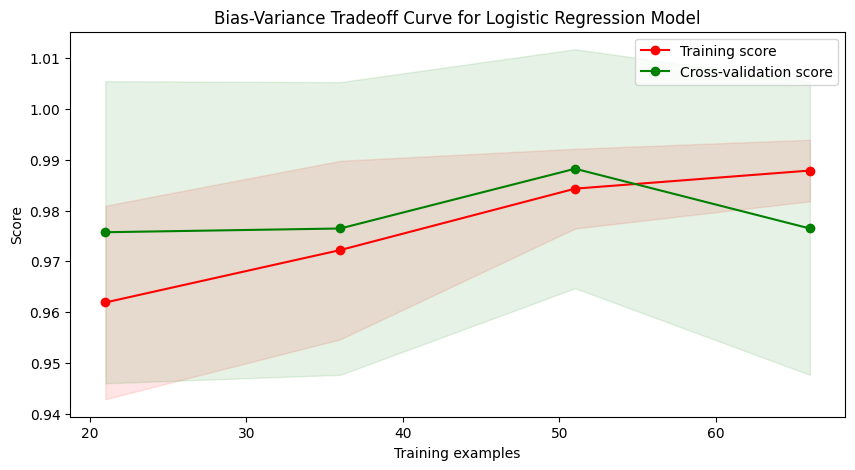

In [57]:
from sklearn.model_selection import learning_curve

# Defining function to plot bias-variance tradeoff
def plot_bias_variance_tradeoff(estimator, title):
    train_sizes, train_scores, test_scores = learning_curve(estimator, X_train_normalized_df, Y_train, train_sizes=np.linspace(0.1, 1.0, 5), cv=5)

    train_mean = np.mean(train_scores, axis=1)
    train_std = np.std(train_scores, axis=1)

    test_mean = np.mean(test_scores, axis=1)
    test_std = np.std(test_scores, axis=1)

    plt.figure(figsize=(10, 5))
    plt.title(title)
    plt.xlabel("Training examples")
    plt.ylabel("Score")

    plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.1, color="r")
    plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_mean, 'o-', color="r", label="Training score")
    plt.plot(train_sizes, test_mean, 'o-', color="g", label="Cross-validation score")

    plt.legend(loc="best")
    plt.show()

# Plotting the bias-variance tradeoff curve for logistic regression model
plot_bias_variance_tradeoff(grid_search_lr, "Bias-Variance Tradeoff Curve for Logistic Regression Model")


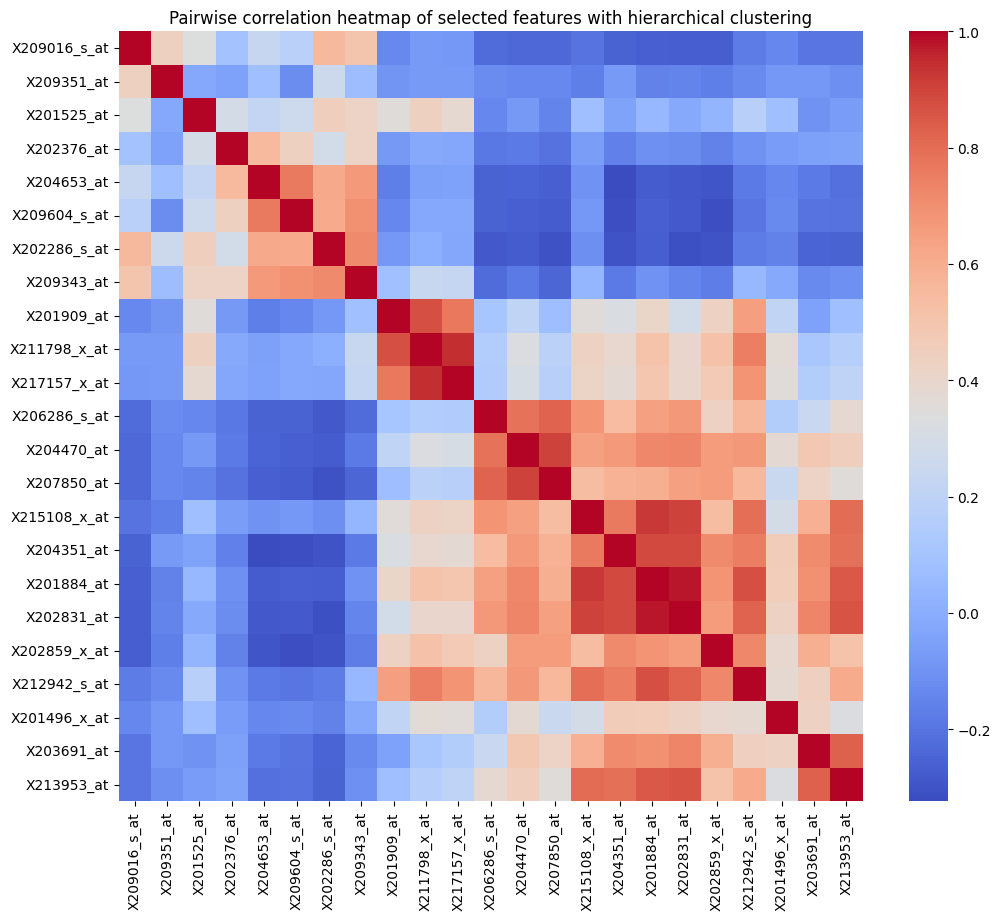

In [50]:
import seaborn as sns
from scipy.cluster.hierarchy import linkage, leaves_list

# creating a dataframe with selected features
selected_data = X_train_normalized_df[selected_features]

# getting the correlation matrix
corr_matrix = selected_data.corr()

# Perform hierarchical clustering on the correlation matrix
linkage_matrix = linkage(corr_matrix, method='ward')
reordered_indices = leaves_list(linkage_matrix)
reordered_corr_matrix = corr_matrix.iloc[reordered_indices, reordered_indices]

# plotting the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(reordered_corr_matrix, cmap='coolwarm', fmt='.2f')
plt.title("Pairwise correlation heatmap of selected features with hierarchical clustering")
plt.show()
# reordered_corr_matrix.to_csv('pairwise_correaltion_matrix.csv')

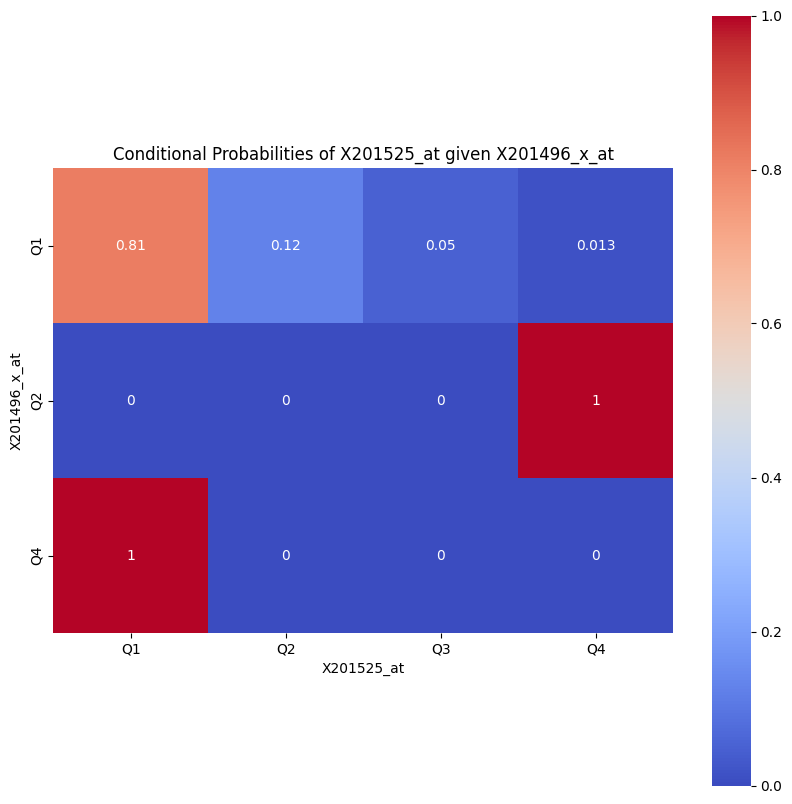

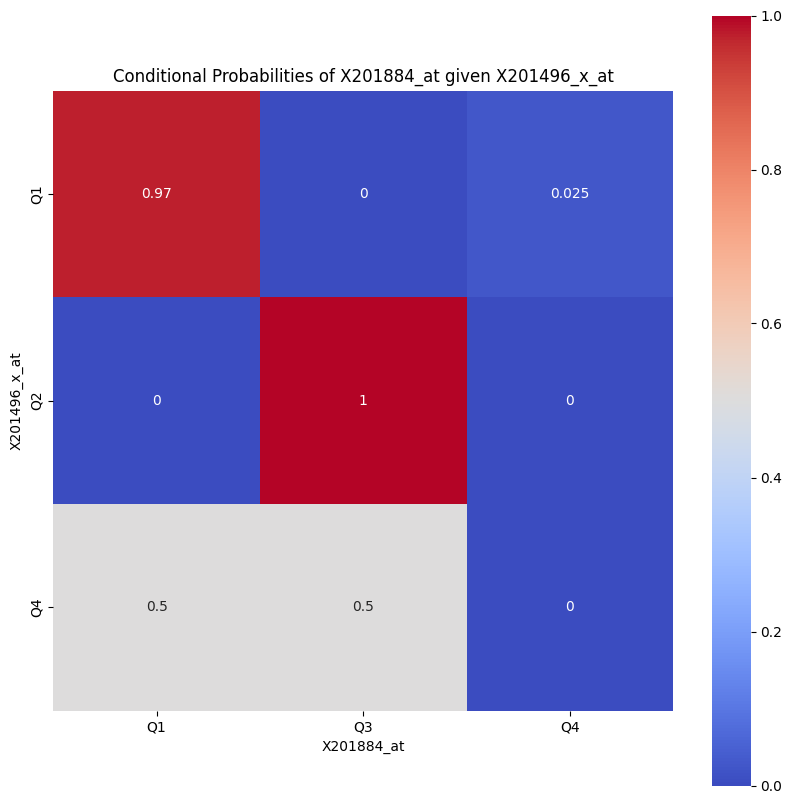

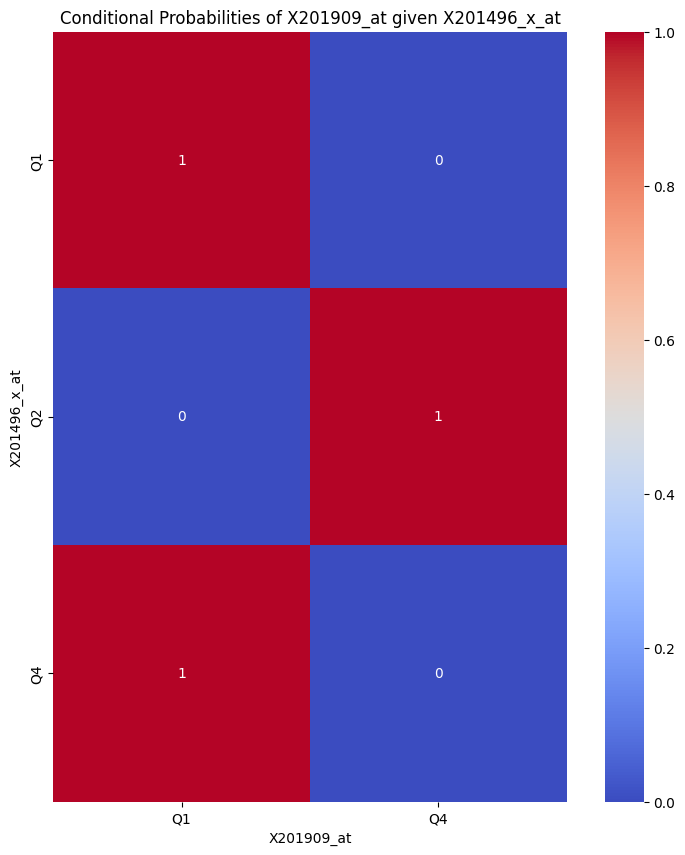

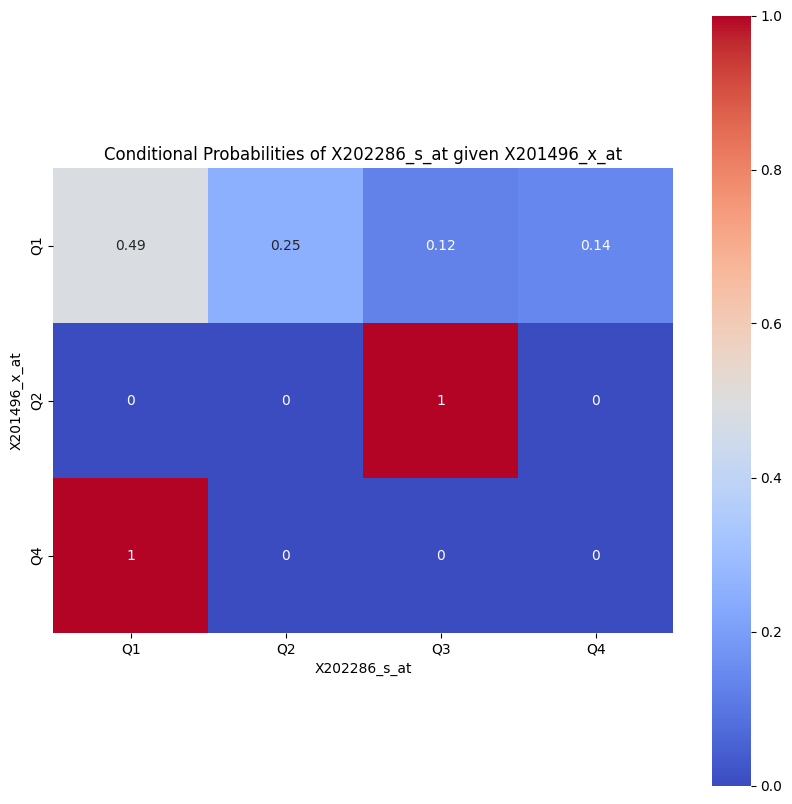

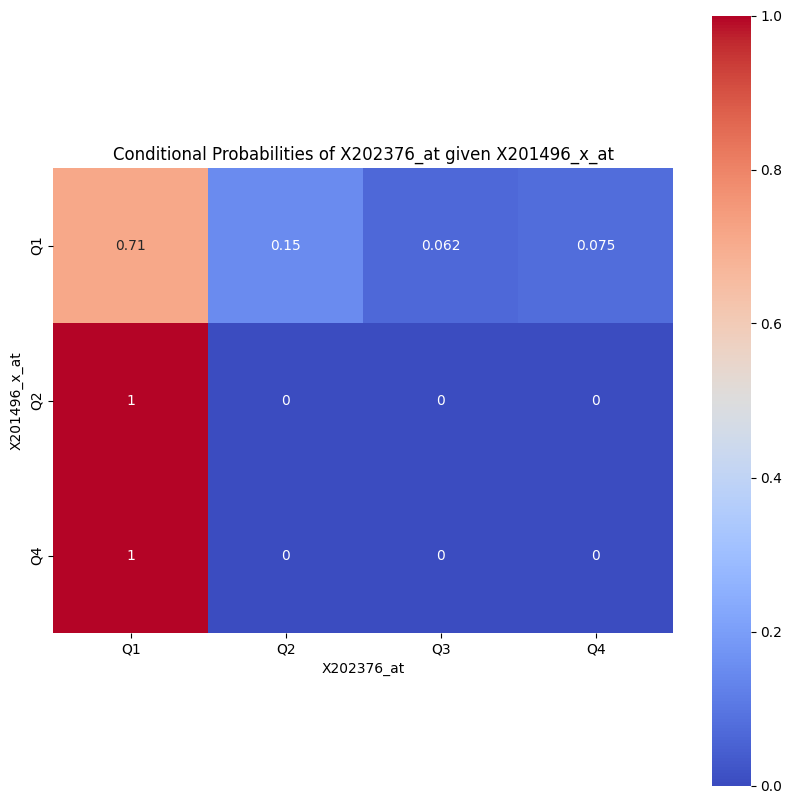

...

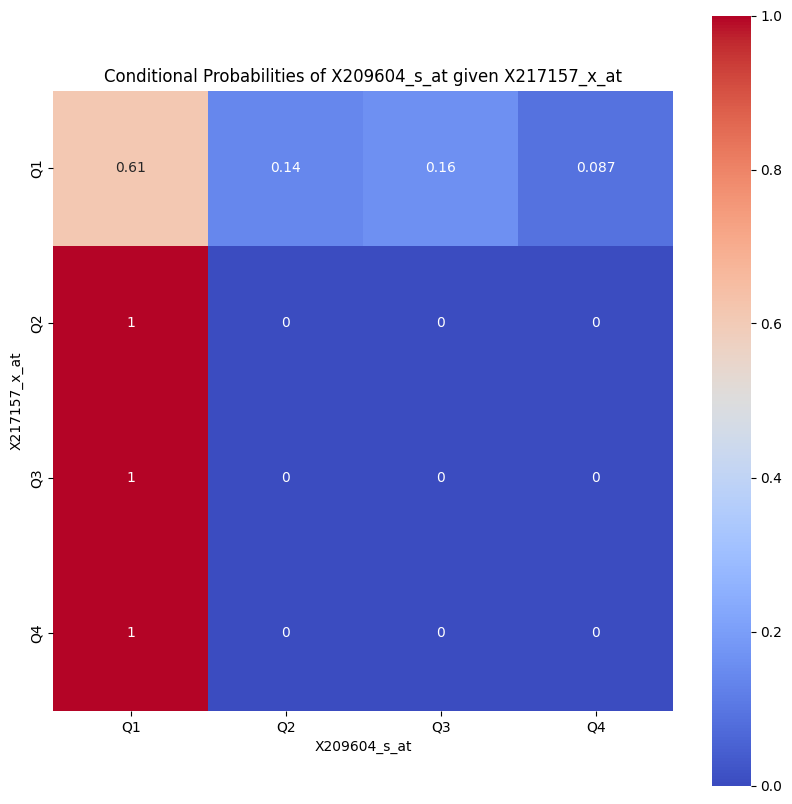

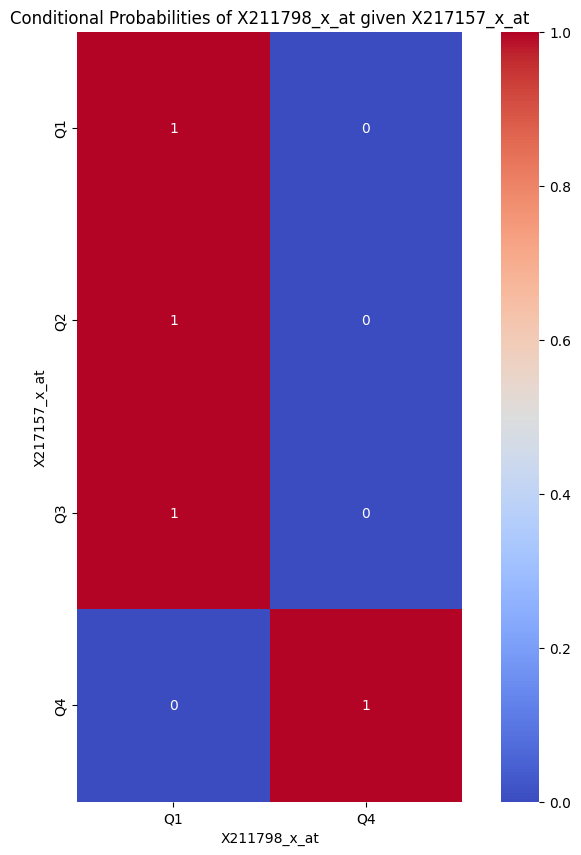

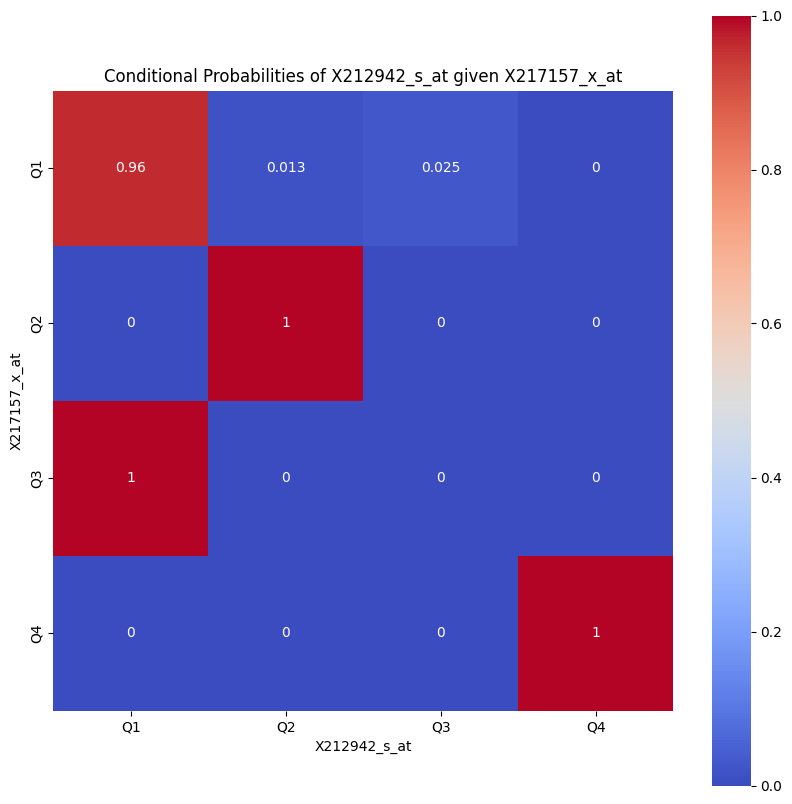

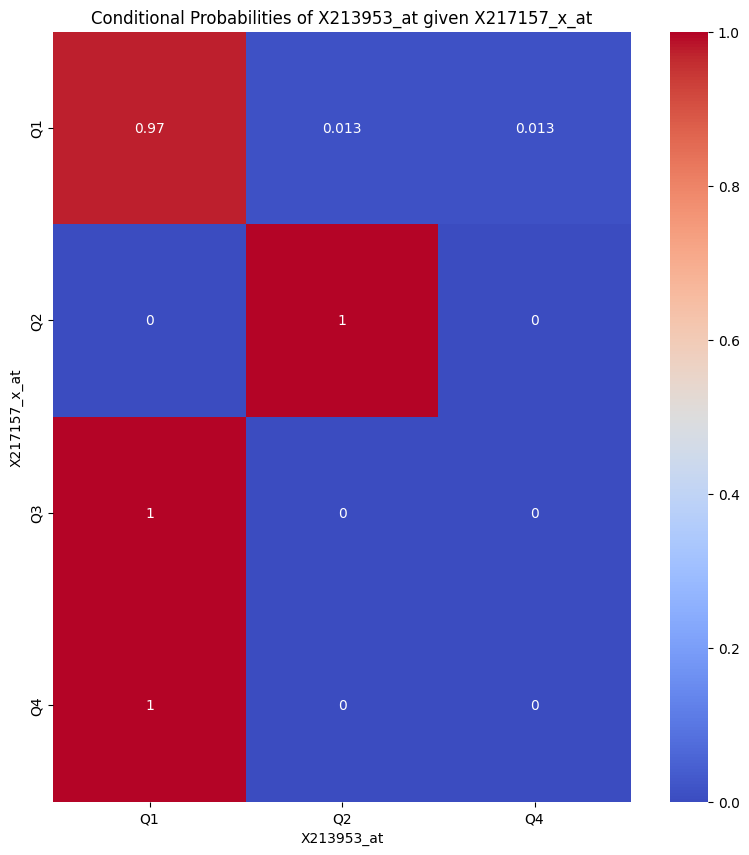

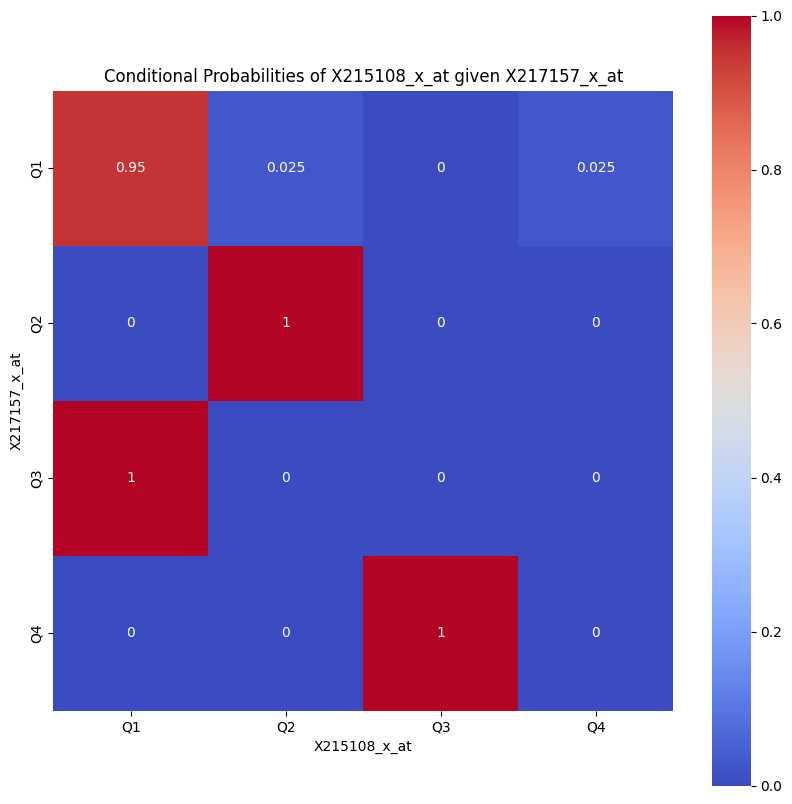

In [58]:
# visualizing conditional probabilities for each pair of features
def plot_conditional_prob(feature1, feature2):
    # Bin the continuous features into 4 equal-width bins
    X_train_binned = X_train_normalized_df.copy()
    X_train_binned[feature1] = pd.cut(X_train_normalized_df[feature1], 4, labels=["Q1", "Q2", "Q3", "Q4"])
    X_train_binned[feature2] = pd.cut(X_train_normalized_df[feature2], 4, labels=["Q1", "Q2", "Q3", "Q4"])
    
    contingency_table = pd.crosstab(X_train_binned[feature1], X_train_binned[feature2])
    prob_feature2_given_feature1 = contingency_table.div(contingency_table.sum(axis=1), axis=0)

    plt.figure(figsize=(10, 10))
    sns.heatmap(prob_feature2_given_feature1, annot=True, cmap='coolwarm', square=True)
    plt.title(f"Conditional Probabilities of {feature2} given {feature1}")
    plt.show()
    
# looping through all pairs of features and compute conditional probabilities
for i, feature1 in enumerate(selected_features):
    for j, feature2 in enumerate(selected_features):
        if i != j:
            plot_conditional_prob(feature1, feature2)

In [59]:
def compute_conditional_prob(feature1, feature2):
    X_train_binned = X_train_normalized_df.copy()
    X_train_binned[feature1] = pd.cut(X_train_normalized_df[feature1], 4, labels=["Q1", "Q2", "Q3", "Q4"])
    X_train_binned[feature2] = pd.cut(X_train_normalized_df[feature2], 4, labels=["Q1", "Q2", "Q3", "Q4"])
    
    contingency_table = pd.crosstab(X_train_binned[feature1], X_train_binned[feature2])

    if not contingency_table.empty:
        prob_feature2_given_feature1 = contingency_table.div(contingency_table.sum(axis=1), axis=0)
        return prob_feature2_given_feature1
    else:
        return None

# Compute and store the conditional probabilities in a nested dictionary
conditional_probs = {}

for i, feature1 in enumerate(selected_features):
    conditional_probs[feature1] = {}
    for j, feature2 in enumerate(selected_features):
        if i != j:
            conditional_probs[feature1][feature2] = compute_conditional_prob(feature1, feature2)

In [61]:
prob_feature2_given_feature1 = conditional_probs[selected_features[0]][selected_features[1]]
print(prob_feature2_given_feature1)

X201525_at        Q1     Q2    Q3      Q4
X201496_x_at                             
Q1            0.8125  0.125  0.05  0.0125
Q2            0.0000  0.000  0.00  1.0000
Q4            1.0000  0.000  0.00  0.0000


In [62]:
latex_table = prob_feature2_given_feature1.to_latex()
print(latex_table)


\begin{tabular}{lrrrr}
\toprule
X201525_at & Q1 & Q2 & Q3 & Q4 \\
X201496_x_at &  &  &  &  \\
\midrule
Q1 & 0.812500 & 0.125000 & 0.050000 & 0.012500 \\
Q2 & 0.000000 & 0.000000 & 0.000000 & 1.000000 \\
Q4 & 1.000000 & 0.000000 & 0.000000 & 0.000000 \\
\bottomrule
\end{tabular}



In [63]:
import numpy as np
import pandas as pd
from scipy.stats import chi2_contingency

X_train_binned = X_train_normalized_df.copy()
X_train_binned[feature1] = pd.cut(X_train_normalized_df[feature1], 4, labels=["Q1", "Q2", "Q3", "Q4"])
X_train_binned[feature2] = pd.cut(X_train_normalized_df[feature2], 4, labels=["Q1", "Q2", "Q3", "Q4"])

def cramers_v(contingency_table):
    chi2, _, _, _ = chi2_contingency(contingency_table)
    n = contingency_table.sum().sum()
    phi2 = chi2 / n
    r, k = contingency_table.shape
    phi2_corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
    r_corr = r - ((r-1)**2)/(n-1)
    k_corr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2_corr / min((k_corr-1), (r_corr-1)))

# Compute Cramér's V for each pair of features and store them in a nested dictionary
cramers_v_values = {}

for i, feature1 in enumerate(selected_features):
    cramers_v_values[feature1] = {}
    for j, feature2 in enumerate(selected_features):
        if i != j:
            contingency_table = pd.crosstab(X_train_binned[feature1], X_train_binned[feature2])
            cramers_v_values[feature1][feature2] = cramers_v(contingency_table)

# Convert the nested dictionary to a DataFrame
cramers_v_df = pd.DataFrame(cramers_v_values)

In [66]:
threshold = 0.5  # Adjust the threshold according to your desired level of significance

# Find pairs with Cramér's V values above the threshold
significant_pairs = list(zip(*np.where(cramers_v_df > threshold)))

# Filter out pairs where feature1 == feature2
significant_pairs_filtered = [(selected_features[i], selected_features[j]) for i, j in significant_pairs if i != j]

print("Significant pairs of features:")
print(significant_pairs_filtered)
# Create a dataframe from the list
significant_pairs_df = pd.DataFrame(significant_pairs_filtered, columns=['Feature1', 'Feature2'])

# Display the dataframe
print(significant_pairs_df)

# save the dataframe to a csv file
# significant_pairs_df.to_csv('significant_pairs.csv', index=False)

Significant pairs of features:
[('X201496_x_at', 'X202286_s_at'), ('X201496_x_at', 'X215108_x_at'), ('X201525_at', 'X202831_at'), ('X201525_at', 'X204470_at'), ('X201525_at', 'X206286_s_at'), ('X201525_at', 'X207850_at'), ('X201525_at', 'X213953_at'), ('X201525_at', 'X215108_x_at'), ('X201884_at', 'X204470_at'), ('X201884_at', 'X206286_s_at'), ('X201884_at', 'X207850_at'), ('X201884_at', 'X212942_s_at'), ('X201909_at', 'X201525_at'), ('X201909_at', 'X202376_at'), ('X201909_at', 'X209016_s_at'), ('X201909_at', 'X209351_at'), ('X201909_at', 'X209604_s_at'), ('X202286_s_at', 'X209016_s_at'), ('X202286_s_at', 'X209343_at'), ('X202286_s_at', 'X209351_at'), ('X202286_s_at', 'X209604_s_at'), ('X202376_at', 'X201884_at'), ('X202376_at', 'X202859_x_at'), ('X202376_at', 'X203691_at'), ('X202376_at', 'X204351_at'), ('X202376_at', 'X204470_at'), ('X202376_at', 'X206286_s_at'), ('X202376_at', 'X207850_at'), ('X202376_at', 'X212942_s_at'), ('X202376_at', 'X213953_at'), ('X202831_at', 'X203691_at'), 

In [67]:
# Function to compute chi2_stat, P-value, and cramers_V for a pair of features
def compute_chi2_cramers_v(feature1, feature2):
    X_train_binned = X_train_normalized_df.copy()
    X_train_binned[feature1] = pd.cut(X_train_normalized_df[feature1], 4, labels=["Q1", "Q2", "Q3", "Q4"])
    X_train_binned[feature2] = pd.cut(X_train_normalized_df[feature2], 4, labels=["Q1", "Q2", "Q3", "Q4"])

    contingency_table = pd.crosstab(X_train_binned[feature1], X_train_binned[feature2])
    chi2_stat, p_value, _, _ = chi2_contingency(contingency_table)
    cramers_v = np.sqrt(chi2_stat / (contingency_table.sum().sum() * (min(contingency_table.shape) - 1)))

    return chi2_stat, p_value, cramers_v

# Update significant_pairs_filtered with chi2_stat, P-value, and cramers_V
significant_pairs_info = []

for pair in significant_pairs_filtered:
    chi2_stat, p_value, cramers_v = compute_chi2_cramers_v(pair[0], pair[1])
    significant_pairs_info.append((pair[0], pair[1], chi2_stat, p_value, cramers_v))

# Convert to DataFrame
significant_pairs_df = pd.DataFrame(significant_pairs_info, columns=['Feature1', 'Feature2', 'Chi2_stat', 'P-value', 'Cramers_V'])
print(significant_pairs_df)

         Feature1      Feature2   Chi2_stat       P-value  Cramers_V
0    X201496_x_at  X202286_s_at    8.677273  1.925580e-01   0.228632
1    X201496_x_at  X215108_x_at   95.656602  2.018033e-18   0.759108
2      X201525_at    X202831_at   41.680333  3.759523e-06   0.409134
3      X201525_at    X204470_at   10.113564  3.413701e-01   0.201536
4      X201525_at  X206286_s_at    0.743284  9.935089e-01   0.066915
..            ...           ...         ...           ...        ...
122  X215108_x_at  X206286_s_at   95.622917  2.050894e-18   0.758974
123  X215108_x_at  X209016_s_at    2.479221  9.814371e-01   0.099783
124  X217157_x_at    X201525_at   41.445802  4.148802e-06   0.407982
125  X217157_x_at  X211798_x_at   83.000000  6.972670e-18   1.000000
126  X217157_x_at  X215108_x_at  110.028896  1.450610e-19   0.664743

[127 rows x 5 columns]


In [68]:
# Sort the DataFrame by Cramers' V values in descending order
sorted_significant_pairs_df = significant_pairs_df.sort_values(by='Cramers_V', ascending=False)

# Get the top 10 pairs
top_10_pairs = sorted_significant_pairs_df.head(10)
print(top_10_pairs)

         Feature1      Feature2   Chi2_stat       P-value  Cramers_V
101  X211798_x_at    X202831_at   83.000000  6.972670e-18   1.000000
125  X217157_x_at  X211798_x_at   83.000000  6.972670e-18   1.000000
109  X212942_s_at    X201884_at  144.724684  1.007932e-28   0.933721
11     X201884_at  X212942_s_at  144.724684  1.007932e-28   0.933721
34     X202831_at  X212942_s_at  206.974684  1.140966e-39   0.911715
110  X212942_s_at    X202831_at  206.974684  1.140966e-39   0.911715
77   X206286_s_at    X204470_at  124.014935  2.335406e-24   0.864337
46     X203691_at    X213953_at  123.994219  2.358947e-24   0.864264
117  X212942_s_at  X215108_x_at  178.612610  9.871182e-34   0.846947
35     X202831_at    X213953_at  103.750000  4.136184e-20   0.790569


In [112]:
from scipy.stats import ttest_ind

def t_test(feature):
    # Perform an independent t-test between two groups
    group1 = X_train_normalized_df.reset_index(drop=True).loc[Y_train.reset_index(drop=True) == 'B', feature]
    group2 = X_train_normalized_df.reset_index(drop=True).loc[Y_train.reset_index(drop=True) == 'C', feature]
    t_stat, p_value = ttest_ind(group1, group2)

    return t_stat, p_value

t_test_results = []

# Looping through all features and compute t-statistics and p-values
for feature in X_train_normalized_df.columns:
    t_stat, p_value = t_test(feature)
    t_test_results.append((feature, t_stat, p_value))



C:\Users\sarathkumar\AppData\local\Temp\ipykernel_7584\601970191.py:7: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  t_stat, p_value = ttest_ind(group1, group2)


In [113]:
t_test_results

[('X201262_s_at', -1.009578772824756, 0.31570352766971455),
 ('X201496_x_at', -2.6068550601249885, 0.010874322325208708),
 ('X201497_x_at', -2.628925133569891, 0.010245911270268434),
 ('X201525_at', 3.4257299338062617, 0.000965331138403221),
 ('X201884_at', -5.242731890861648, 1.2336348898285543e-06),
 ('X201909_at', -2.933106258615552, 0.004362712049195225),
 ('X202018_s_at', 4.250412471469619, 5.670466164752569e-05),
 ('X202037_s_at', 0.7792123338841311, 0.4381253271352967),
 ('X202286_s_at', 9.09864098856378, 5.070490513622592e-14),
 ('X202376_at', 4.8383609884233865, 6.153287871537976e-06),
 ('X202437_s_at', 0.04406915038309171, 0.9649577430937848),
 ('X202504_at', -1.5803025820079832, 0.1179349287443172),
 ('X202575_at', 5.556524598447679, 3.4125380009590026e-07),
 ('X202831_at', -5.398651300032583, 6.539476351890133e-07),
 ('X202859_x_at', -5.929013974529571, 7.152148216311758e-08),
 ('X202952_s_at', -0.4204177189761787, 0.6752935803647502),
 ('X202992_at', -1.66607859861594, 0.0

In [115]:
t_test_df = pd.DataFrame(t_test_results, columns=['Feature1', 't_stat', 'p_value'])

# Sort the DataFrame by p-value in ascending order
sorted_t_test_pair_df = t_test_df.sort_values(by='p_value', ascending=True)
sorted_t_test_pair_df.head(10)

,Feature1,t_stat,p_value
8,X202286_s_at,9.098641,5.070491e-14
47,X204653_at,8.035640,6.391251e-12
106,X209343_at,7.792046,1.926944e-11
113,X209604_s_at,7.738526,2.454496e-11
57,X205225_at,6.495748,6.225158e-09
111,X209602_s_at,6.223971,2.024608e-08
100,X209016_s_at,6.044130,4.380923e-08
14,X202859_x_at,-5.929014,7.152148e-08
39,X204351_at,-5.908704,7.795561e-08
161,X218502_s_at,5.873937,9.032030e-08


In [116]:
sorted_t_test_pair_df.head(10).to_csv('sorted_t_test_pair_df.csv', index=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


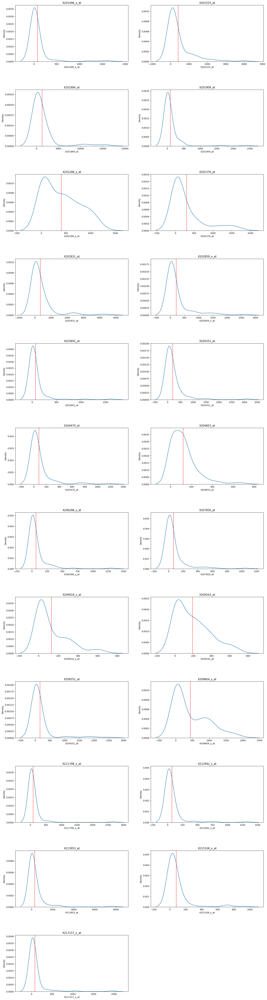

In [118]:
import seaborn as sns
import matplotlib.pyplot as plt

# dataframe with only the selected features
data = df[selected_features]

# Create a grid of subplots
n_rows = 12
n_cols = 2
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 80))

for i, col in enumerate(data.columns):
    row = i // n_cols
    col = i % n_cols

    # Create the KDE plot for each feature
    sns.kdeplot(data=data, x=data.columns[i], ax=axes[row, col])
    axes[row, col].set_title(data.columns[i])

    # Add a vertical line for the mean value
    mean_val = data.iloc[:, i].mean()
    axes[row, col].axvline(mean_val, color='r', linestyle='--', label='Mean')

# Remove empty subplots
for i in range(len(data.columns), n_rows * n_cols):
    row = i // n_cols
    col = i % n_cols
    axes[row, col].set_visible(False)

# Adjust spacing between subplots
plt.subplots_adjust(hspace=0.5, wspace=0.2)
# show legend for mean values
plt.legend()
plt.show()


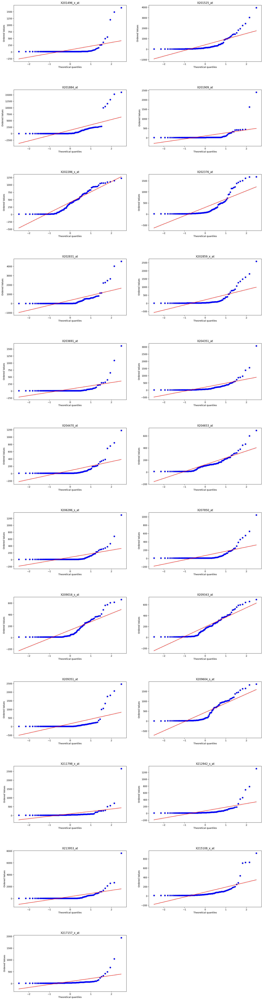

In [110]:
import scipy.stats as stats
import matplotlib.pyplot as plt

# Assuming your data is stored in a DataFrame called `data`
data = df[selected_features]

# Create a grid of subplots
n_rows = 12
n_cols = 2
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 80))

for i, col in enumerate(data.columns):
    row = i // n_cols
    col = i % n_cols
    
    # Create the Q-Q plot for each feature
    stats.probplot(data.iloc[:, i], plot=axes[row, col])
    axes[row, col].set_title(data.columns[i])

# Remove empty subplots
for i in range(len(data.columns), n_rows * n_cols):
    row = i // n_cols
    col = i % n_cols
    axes[row, col].set_visible(False)

# Adjust spacing between subplots
plt.subplots_adjust(hspace=0.5, wspace=0.2)
plt.show()
